Implementation of Conditional GANS for Image Defencing


In [1]:
import tensorflow as tf
import numpy as np

import os
import time

from matplotlib import pyplot as plt
from IPython import display
import numpy as np


2023-06-12 11:26:17.398362: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-12 11:26:18.421883: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/opt/anaconda3/envs/tf-gpu/lib/python3.8/site-packages/requests/__init__.py:109: RequestsDependencyWarning: urllib3 (1.26.14) or chardet (None)/charset_normalizer (3.1.0) doesn't match a supported version!
  warnings.warn(


In [2]:

tf.__version__
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


2023-06-12 11:26:22.308773: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /device:GPU:0 with 11372 MB memory:  -> device: 0, name: NVIDIA TITAN Xp, pci bus id: 0000:17:00.0, compute capability: 6.1
2023-06-12 11:26:22.311370: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /device:GPU:1 with 10365 MB memory:  -> device: 1, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:18:00.0, compute capability: 6.1


True

In [3]:
gpus = tf.config.experimental.list_physical_devices('GPU')
print (gpus)
if gpus:
  try:
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
  except RuntimeError as e:
    print(e)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]


Seperating and Visualising Sample Image as fenced and de-fenced

In [4]:
BUFFER_SIZE = 400
BATCH_SIZE = 4
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [5]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.image.decode_jpeg(image)
  image = image

  w = tf.shape(image)[1]

  w = w // 2
  real_image = image[:, :w, :]
  input_image = image[:, w:, :]

  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)
  fence = input_image - real_image

  return input_image, real_image, (fence)

In [6]:
fence_tensor=tf.cast

2023-06-12 11:26:25.075081: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 11372 MB memory:  -> device: 0, name: NVIDIA TITAN Xp, pci bus id: 0000:17:00.0, compute capability: 6.1
2023-06-12 11:26:25.075362: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 10365 MB memory:  -> device: 1, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:18:00.0, compute capability: 6.1
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


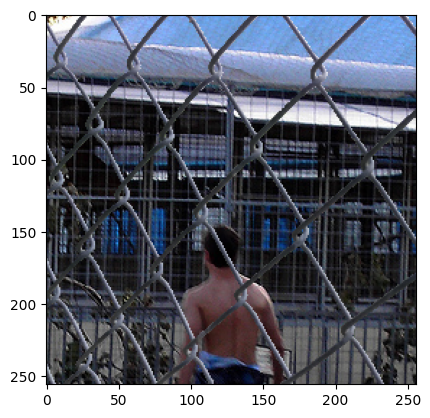

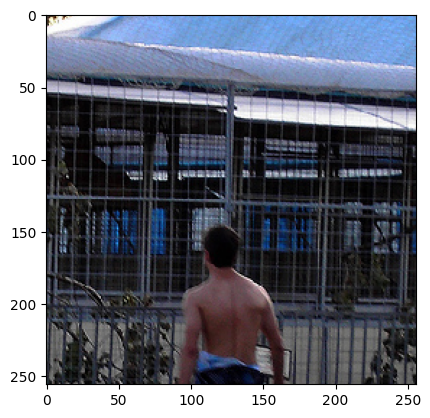

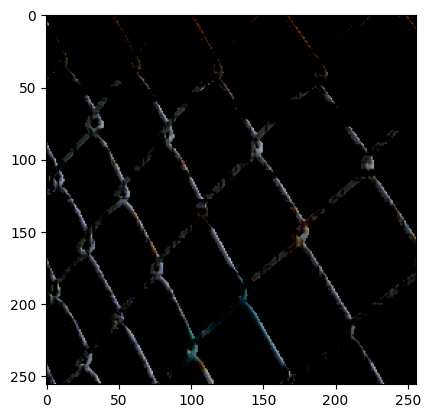

In [7]:
inp, re, fe = load(r"/DATA/shorya/ImageDefencing/train_images/images/2008_000630.png")
# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(inp/255.0)
plt.figure()
plt.imshow(re/255.0)
plt.figure()
plt.imshow(fe/255.0)

In [8]:

inp = tf.image.resize(inp, [256, 256],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

Random Cropping and resizing of images to bring in all features and increase the visual perception depth of latent space 

In [9]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [10]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [11]:
# normalizing the images to [-1, 1]

def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [12]:
@tf.function()
def random_jitter(input_image, real_image):
  # First resize the input image to 286 x 286 with 3 channels
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # randomly re-cropping to 256 x 256 with 3 channels
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # flip/mirror the input and target image to get more visual data to train
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

Display the images after changes


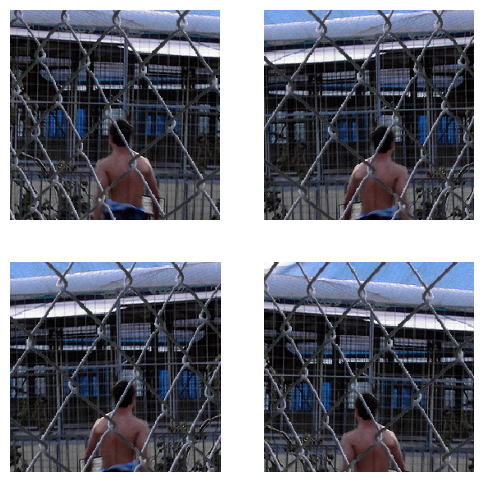

In [13]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i+1)
  plt.imshow(rj_inp/255.0)
  plt.axis('off')
plt.show()

Defining the train and test dataset functions

In [14]:
def load_image_train(image_file):
  # printgetsizeof((image_file))
  input_image, real_image , fe = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [15]:
def load_image_test(image_file):
  input_image, real_image, fe = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

The Input stream

In [16]:
train_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_acc_dataset = train_dataset
train_dataset = train_dataset.batch(BATCH_SIZE)
train_acc_dataset = train_acc_dataset.batch(1)

In [17]:
test_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
test_dataset = test_dataset.map(load_image_test)
test_acc_dataset = test_dataset
test_dataset = test_dataset.batch(BATCH_SIZE)
test_acc_dataset = test_acc_dataset.batch(1)

In [18]:
papers_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
papers_dataset = papers_dataset.map(load_image_test)
papers_dataset = papers_dataset.batch(1)

In [19]:
irregular_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
irregular_dataset = irregular_dataset.map(load_image_test)
irregular_dataset = irregular_dataset.batch(1)

In [20]:
broken_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
broken_dataset = broken_dataset.map(load_image_test)
broken_dataset = broken_dataset.batch(1)

In [21]:
flip_dataset = tf.data.Dataset.list_files(r"/DATA/shorya/ImageDefencing/train_images/images/*.png")
flip_dataset = flip_dataset.map(load_image_test)
flip_dataset = flip_dataset.batch(1)

In [22]:
OUTPUT_CHANNELS = 3

In [23]:
print(len(train_dataset))
print(len(test_dataset))
print(len(train_acc_dataset))
print(len(test_acc_dataset))
print(len(papers_dataset))
print(len(irregular_dataset))
print(len(broken_dataset))
print(len(flip_dataset))

7254
7254
29013
29013
29013
29013
29013
29013


Defining Generator:
A modified U-net:
Convolution
Batch Normalisation
Leaky Relu Activation Function(To bring non linearity into the network)

In [24]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [25]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

2023-06-12 11:26:41.282931: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:424] Loaded cuDNN version 8600


(1, 128, 128, 3)


2023-06-12 11:26:42.222199: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


Decoder:
Transpose Convolution(decreasing the depth of the output layers)
Batch Normalisation
Dropout(to prevent the network from learning specific features and be as random and over viewing as possible)

In [26]:
def upsample(filters, size, apply_dropout=False ,want_layer = False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False,
                                    name = "layer1"))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())
  if want_layer == True:
    global target_layer
    target_layer =result.get_layer('layer1')
  return result

In [27]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


The Downsampling does:
(128, 128, 64)
(64,64,128)
(32,32,256)
(16,16,512)
(8,8,512)
(4,4,512)
(2,2,512)
(1,1,512)
The Upsampling does:
(2,2,1024)
(4,4,1024)
(8,8,1024)
(16,16,1024)
(32,32,512)
(64,64,256)
(128,128,128)

In [28]:
def Student():
  inputs = tf.keras.layers.Input(shape=[256,256,3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  
    downsample(128, 4), 
    downsample(256, 4), 
    downsample(512, 4), 
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  
    upsample(256, 4), 
    upsample(128, 4, want_layer=True),
    upsample(64, 4), 
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  count = 0
  for up, skip in zip(up_stack, skips):
    x = up(x)
    count +=1 
    if count == 3:
      global student_feature_layer
      student_feature_layer = x
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)
  Model1=tf.keras.Model(inputs=inputs, outputs=x)
  Model2=tf.keras.Model(inputs=inputs, outputs=student_feature_layer)
  return Model1,Model2

In [29]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  
    downsample(128, 4), 
    downsample(256, 4), 
    downsample(512, 4), 
    downsample(512, 4), 
    downsample(512, 4),
    downsample(512, 4), 
    downsample(512, 4),
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), 
    upsample(512, 4, apply_dropout=True),
    upsample(512, 4, apply_dropout=True), 
    upsample(512, 4),
    upsample(256, 4), 
    upsample(128, 4),
    upsample(64, 4), 
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  count = 0
  for up, skip in zip(up_stack, skips):
    count +=1
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])
    if count == 7:
      global feature_layer
      feature_layer = x
  

  x = last(x)
  Model1=tf.keras.Model(inputs=inputs, outputs=x)
  Model2=tf.keras.Model(inputs=inputs,outputs=feature_layer)
  return Model1,Model2
  

In [30]:
student,student_feature_generator=Student()
generator, feature_generator=Generator()

In [31]:
student.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_2 (Sequential)      (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_3 (Sequential)      (None, 64, 64, 128)  131584      ['sequential_2[0][0]']           
                                                                                              

In [32]:
student_feature_generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_2 (Sequential)      (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_3 (Sequential)      (None, 64, 64, 128)  131584      ['sequential_2[0][0]']           
                                                                                            

In [33]:
generator.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_10 (Sequential)     (None, 128, 128, 64  3072        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_11 (Sequential)     (None, 64, 64, 128)  131584      ['sequential_10[0][0]']          
                                                                                            

In [34]:
feature_generator.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_10 (Sequential)     (None, 128, 128, 64  3072        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_11 (Sequential)     (None, 64, 64, 128)  131584      ['sequential_10[0][0]']          
                                                                                            

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


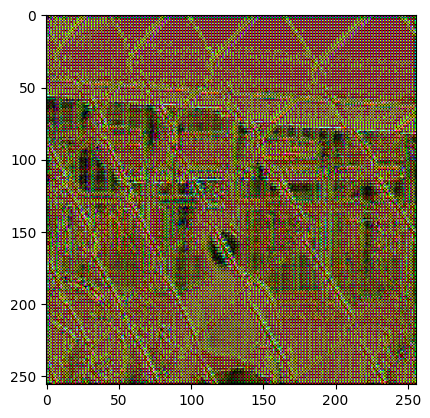

In [35]:
gen_output = generator(inp[tf.newaxis,...], training=False)
feature_gen_output = feature_generator(inp[tf.newaxis,...], training=False)
plt.imshow(gen_output[0,...])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


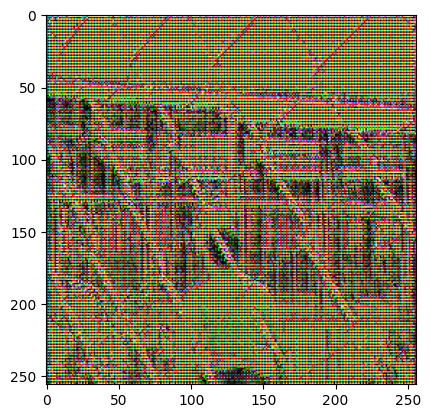

In [36]:
stu_output = student(inp[tf.newaxis,...], training=False)
feature_stu_output = student_feature_generator(inp[tf.newaxis,...], training=False)
plt.imshow(stu_output[0,...])

we now define the Generator Loss

> Sigmoid cross Entropy loss between generated images and array of 1's

> A mean square error loss between input and target images which renders structural similarity to the input and target images



In [37]:
LAMBDA = 2
ALPHA = 0.1
BETA = 10
GAMMA = 1

In [38]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [39]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
  print(layer.name)


input_3
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [40]:
gen_output_layers = ['block5_conv2'] 

target_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_gen_output_layers = len(gen_output_layers)
num_target_layers = len(target_layers)
print(num_target_layers)

5


In [41]:
def vgg_layers(layer_names):
  """ Creates a vgg model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False
  
  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

In [42]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [43]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, target_layers, gen_output_layers):
    super(StyleContentModel, self).__init__()
    self.vgg =  vgg_layers(target_layers + gen_output_layers)
    self.target_layers = target_layers
    self.gen_output_layers = gen_output_layers
    self.num_target_layers = len(target_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    target_outputs, gen_output_outputs = (outputs[:self.num_target_layers], 
                                      outputs[self.num_target_layers:])

    style_outputs = [gram_matrix(target_output)
                     for target_output in target_outputs]

    gen_output_dict = {gen_output_name:value 
                    for gen_output_name, value 
                    in zip(self.gen_output_layers, gen_output_outputs)}

    target_dict = {target_name:value
                  for target_name, value
                  in zip(self.target_layers, target_outputs)}
    
    return {'gen_output':gen_output_dict, 'target':target_dict}

In [44]:
extractor = StyleContentModel(target_layers, gen_output_layers)

In [45]:
target_weight=1e-2
gen_output_weight=1e4

In [46]:
def generator_loss(input,disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
  mask_loss= loss_object((input-gen_output),(input-target))
  target_targets = extractor(target)['target']
  gen_output_targets = extractor(gen_output)['gen_output']
  def perceptual_loss(outputs):
    target_outputs=outputs['target']
    gen_output_outputs = outputs['gen_output']
 
    target_loss = tf.add_n([tf.reduce_mean((target_outputs[name]-target_targets[name])**2) 
                           for name in target_outputs.keys()])
    target_loss *= target_weight / num_target_layers
 
    gen_output_loss = tf.add_n([tf.reduce_mean((gen_output_outputs[name]-gen_output_targets[name])**2) 
                             for name in gen_output_outputs.keys()])
    gen_output_loss *= gen_output_weight / num_gen_output_layers
    perceptual_loss = target_loss + gen_output_loss
    return perceptual_loss
 
  p_loss= perceptual_loss(extractor(gen_output))
 
  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
 
  total_gen_loss = (ALPHA*gan_loss) + (BETA * l1_loss)+(LAMBDA*p_loss)+(GAMMA*mask_loss)
 
  return total_gen_loss, gan_loss, l1_loss,p_loss,mask_loss

In [47]:
def student_loss(disc_stu_output, stu_output, target):
  stu_loss = loss_object(tf.ones_like(disc_stu_output), disc_stu_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - stu_output))

  total_stu_loss = stu_loss + (100 * l1_loss)

  return total_stu_loss, stu_loss, l1_loss

In [48]:
def feature_loss(y_true,y_pred):

    return tf.reduce_mean(tf.abs(y_true - y_pred))



We now implement the Patch GAN discriminator to build the dicriminator,that renders a generated and input pair as fake and input and target pair as real,the Discriminator receives concatenated pairs of these inputs 

In [49]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) #  (256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (128, 128, 64)
  down2 = downsample(128, 4)(down1) # (64, 64, 128)
  down3 = downsample(256, 4)(down2) # (32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [50]:
discriminator = Discriminator()

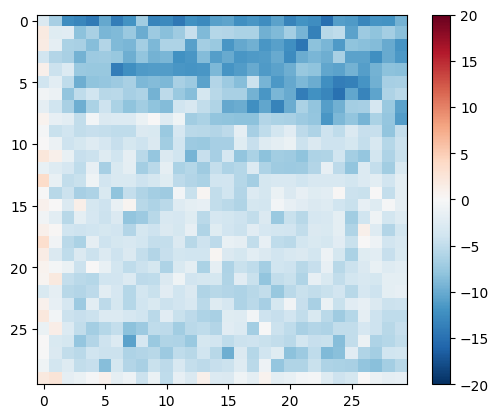

In [51]:
disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

Discriminator has 2 tasks :

> To classify a generator output and input pair as fake

> To classify the target image and input pair as real





In [52]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [53]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)#array of 1's since this target input pair has to be classified as real

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)  #array of 0's since this pair is to be classified as fake

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

Adam Optimiser is used to keep flexibility in learning rates throughout training process.

In [54]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
student_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [55]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 generator=generator)

In [56]:
checkpoint_dir2 = './training_checkpoints2'
checkpoint_prefix2 = os.path.join(checkpoint_dir2, "ckpt2")
checkpoint2 = tf.train.Checkpoint(student_optimizer=student_optimizer,
                                 student=student)

Image Generation Function

In [57]:
def generate_final_images(model, test_input, tar, path, n):
  # prediction = model(test_input, training=True)
  prediction = test_input
  plt.figure(figsize=(5,5))

  plt.imshow(prediction[0] * 0.5 + 0.5)
  plt.axis('off')
  name = path + str(n)+ '.png'
  plt.savefig(name)
  plt.show()

In [58]:
def generate_final_input_images(model, test_input, tar, path, n):
  prediction = test_input
  plt.figure(figsize=(5,5))

  plt.imshow(prediction[0] * 0.5 + 0.5)
  plt.axis('off')
  name = path + str(n)+ '.png'
  plt.savefig(name)
  plt.show()

In [59]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Target', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [74]:
student.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_2 (Sequential)      (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_3 (Sequential)      (None, 64, 64, 128)  131584      ['sequential_2[0][0]']           
                                                                                              

In [60]:
def generate_teacher_images(model, test_input, tar):
  prediction = model(test_input, training=False)
  return prediction[0]

In [61]:
def generate_student_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar, prediction[0]]
  title = ['Input Image', 'Target', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

2023-06-12 11:27:11.287105: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 11:27:11.287762: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


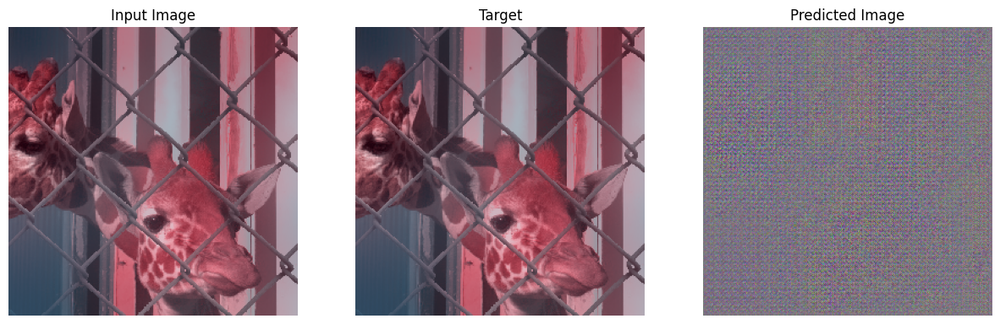

In [62]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_input)

2023-06-12 11:27:14.211521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 11:27:14.211924: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


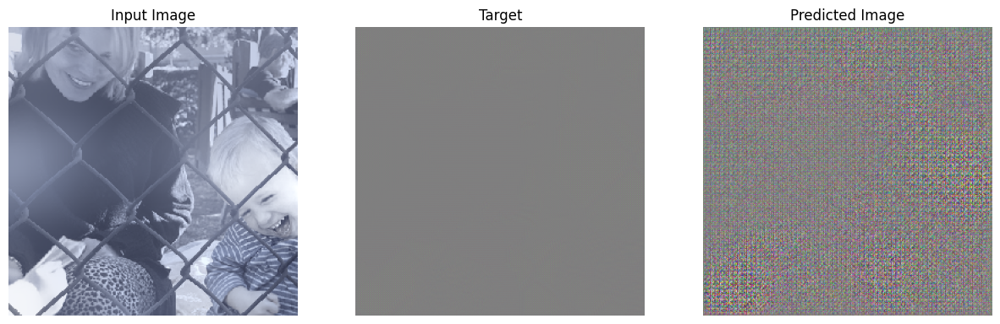

In [63]:
for example_input, example_target in test_dataset.take(1):
  teacher_output = generate_teacher_images(generator, example_input, example_input)
  generate_student_images(student, example_input, teacher_output)

Training Define

In [64]:
EPOCHS = 5

In [65]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [66]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)
    gen1_output=feature_generator(input_image,training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss,perceptual_loss,mask_loss = generator_loss(input_image,disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))
  with summary_writer.as_default():
    # tf.print('gen_total_loss', gen_total_loss)
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    # tf.print('gen_gan_loss', gen_gan_loss)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    # tf.print('gen_l1_loss', gen_l1_loss)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    # tf.print('disc_loss', disc_loss)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [67]:

def train_student_step(input_image, target, epoch):
  with tf.GradientTape() as stu_tape:
    stu_output = student(input_image, training=True)
    stu1_output=student_feature_generator(input_image,training=True)

    disc_stu_output = discriminator([input_image, stu_output], training=True)
    

    stu_total_loss, stu_gan_loss, stu_l1_loss = student_loss(disc_stu_output, stu1_output, target)

  student_gradients = stu_tape.gradient(stu_total_loss,
                                          student.trainable_variables)

  student_optimizer.apply_gradients(zip(student_gradients,
                                          student.trainable_variables))

  with summary_writer.as_default():
    # tf.print('stu_total_loss', stu_total_loss)
    tf.summary.scalar('stu_total_loss', stu_total_loss, step=epoch)
    # tf.print('stu_gan_loss', stu_gan_loss)
    tf.summary.scalar('stu_gan_loss', stu_gan_loss, step=epoch)
    # tf.print('stu_l1_loss', stu_l1_loss)
    tf.summary.scalar('stu_l1_loss', stu_l1_loss, step=epoch)

Actual TRaining Loop

In [68]:
def fit(train_ds, epochs, test_ds):
  timings = np.zeros((epochs,1))
  for epoch in range(epochs):
    start = time.time()

    for example_input, example_target in test_ds.take(1):
      generate_images(generator, example_input, example_input)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
    timings[epoch]  = time.time()-start
  # checkpoint.save(file_prefix = checkpoint_prefix)
  tf.keras.models.save_model(generator, filepath = checkpoint_prefix)
  mean_syn = np.sum(timings) / epochs
  std_syn = np.std(timings)
  print(mean_syn)

2023-06-09 10:54:26.406758: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-09 10:54:26.407103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


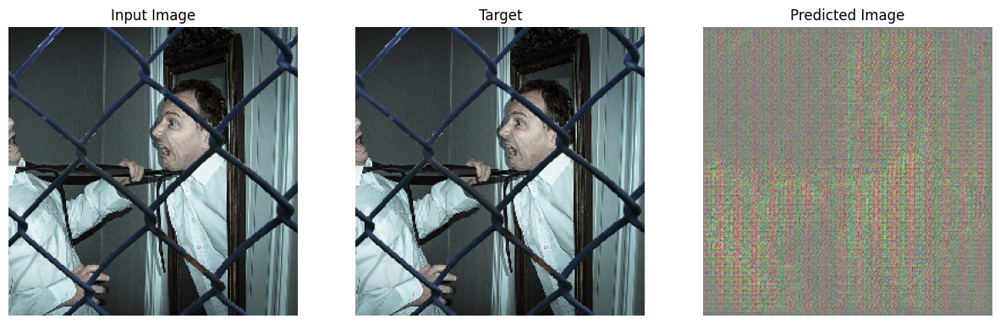

Epoch:  0


2023-06-09 10:54:27.030405: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-09 10:54:27.037877: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-09 10:54:27.038241: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-09 10:54:29.051109: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-06-09 10:54:33.828818: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-06-09 10:54:35.754176: I tensorflow/compiler/xla/service/service.cc:169] XLA service 0x7f0624abb8d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-06-09 10:54:35.754221: I tensorflow/compiler/xla/service/service.cc:177]   StreamExecutor device (0): NVIDIA TITAN Xp, Compute Capability 6.1
2023-06-09 10:54:35.754230: I tensorflow/compiler/xla/service/service.cc:177]   StreamExecutor device (1): NVIDIA GeForce GTX 1080 Ti, Compute Capability 6.1
2023-06-09 10:54:35.766135: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_

...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-09 11:22:35.519188: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer



Time taken for epoch 1 is 1690.7031288146973 sec



2023-06-09 11:22:37.110723: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-09 11:22:37.110985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


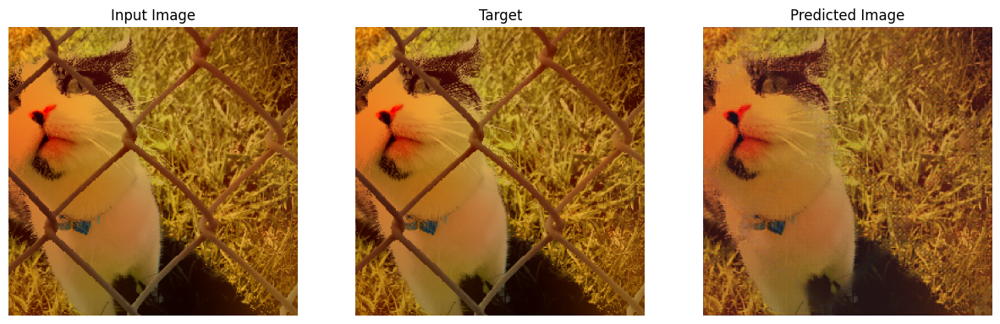

Epoch:  1


2023-06-09 11:22:37.547943: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-09 11:22:37.555522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-09 11:22:37.555871: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-09 11:22:39.574844: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-09 11:50:43.326529: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer



Time taken for epoch 2 is 1686.9396810531616 sec



2023-06-09 11:50:44.050223: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-09 11:50:44.050713: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


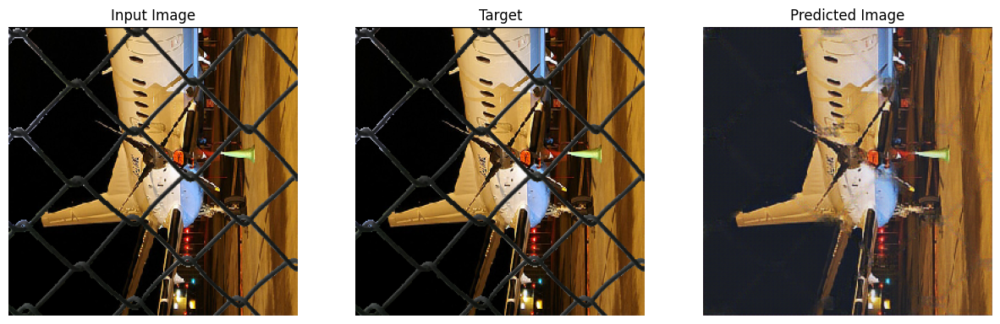

Epoch:  2


2023-06-09 11:50:44.425581: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-09 11:50:44.431628: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-09 11:50:44.431966: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-09 11:50:46.313495: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-09 12:18:52.756030: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer



Time taken for epoch 3 is 1689.3831613063812 sec



2023-06-09 12:18:53.434117: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-09 12:18:53.434407: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


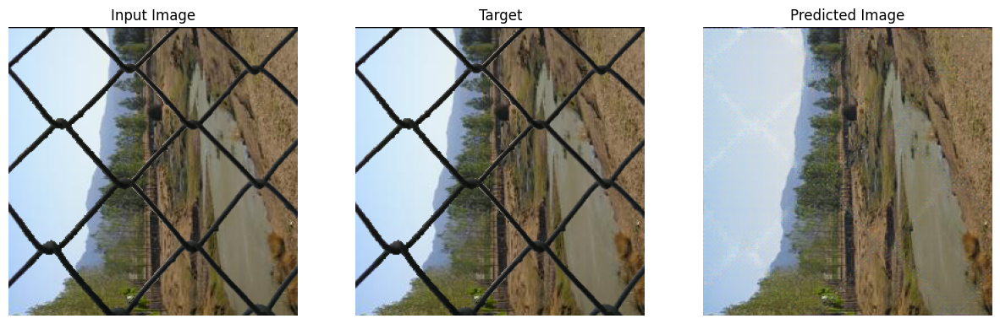

Epoch:  3


2023-06-09 12:18:53.818216: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-09 12:18:53.821432: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-09 12:18:53.821708: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-09 12:18:55.758142: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-09 12:47:03.206999: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer



Time taken for epoch 4 is 1690.5419383049011 sec



2023-06-09 12:47:03.974736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-09 12:47:03.975190: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


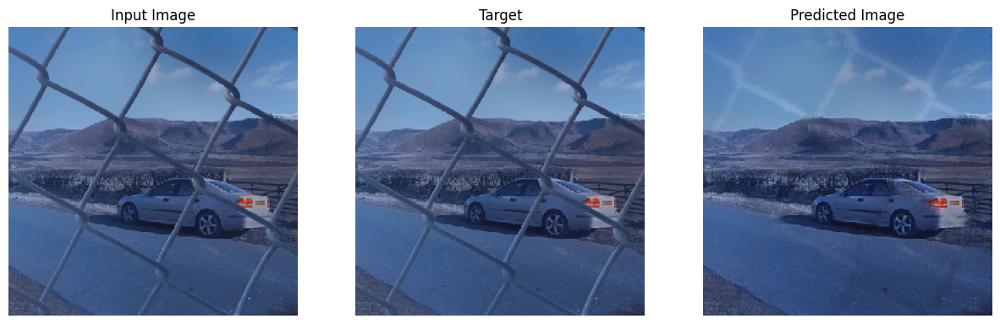

Epoch:  4


2023-06-09 12:47:04.371855: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-09 12:47:04.377614: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-09 12:47:04.377933: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-09 12:47:06.294986: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-09 13:15:08.415420: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/sequential_18/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer



Time taken for epoch 5 is 1685.3437814712524 sec



2023-06-09 13:15:10.137570: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,512]
	 [[{{node inputs}}]]
2023-06-09 13:15:10.165919: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'layer1_input' with dtype float and shape [?,1,1,512]
	 [[{{node layer1_input}}]]
2023-06-09 13:15:10.180638: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'layer1_input' with dtype float and shape [?,1,1,512]
	 [[{{no

INFO:tensorflow:Assets written to: ./training_checkpoints/ckpt/assets


INFO:tensorflow:Assets written to: ./training_checkpoints/ckpt/assets


1688.582360601425


In [71]:
fit(train_dataset, EPOCHS, test_dataset)

In [66]:

#feature_generator = tf.keras.Model(inputs = generator.input, outputs=generator.layers[-2].output)

In [71]:
def generate_teacher_feature_images(model,test_input):
    prediction=model(test_input,training=False)
    return prediction[0]

In [72]:
def student_fit(train_ds, epochs, test_ds, teacher_feature_model):
  timings=np.zeros((epochs,1))
  for epoch in range(epochs):
    start = time.time()

    for example_input, example_target in test_ds.take(1):
      teacher_feature_output = generate_teacher_feature_images(teacher_feature_model, example_input)
      #generate_student_images(student_feature_generator, example_input, teacher_feature_output)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      teacher_output = generate_teacher_images(teacher_model, input_image, target)
      teacher_feature_output=generate_teacher_feature_images(teacher_feature_model,input_image)
      train_student_step(input_image,teacher_feature_output, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint2.save(file_prefix = checkpoint_prefix2)

    print ('Time taken for student epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
    timings[epoch] = time.time()-start
  tf.keras.models.save_model(generator, filepath = checkpoint_prefix2)
  mean_syn = np.sum(timings) / epochs
  std_syn = np.std(timings)
  print(mean_syn)

Run The Training Loop

2023-06-12 11:40:43.346266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 11:40:43.346476: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


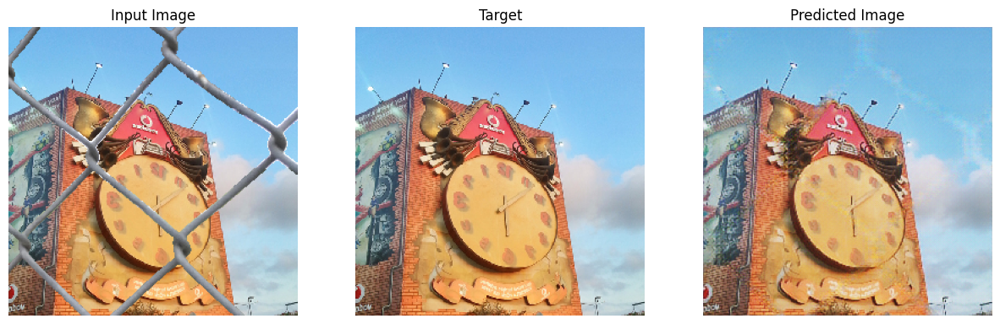

In [82]:
teacher_model = tf.keras.models.load_model(checkpoint_prefix)
for example_input, example_target in test_dataset.take(1):
  generate_images(teacher_model, example_input, example_target)

In [70]:
teacher_feature_model=tf.keras.Model(inputs=teacher_model.input,outputs=teacher_model.layers[-2].output)


In [69]:
try:
  %load_ext tensorboard
  logdir = log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)
  %tensorboard --logdir logs/fit
except:
  pass

Launching TensorBoard...

In [119]:
student = student_model

In [120]:
student_fit(train_dataset,EPOCHS,test_dataset,teacher_feature_model)

2023-06-12 12:17:24.529103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 12:17:24.529517: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


Epoch:  0


2023-06-12 12:17:24.886839: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-12 12:17:24.896228: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]
2023-06-12 12:17:24.896736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype string and shape [29013]
	 [[{{node Placeholder/_4}}]]


.

2023-06-12 12:17:26.772299: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-06-12 12:17:28.670679: I tensorflow/compiler/xla/service/service.cc:169] XLA service 0x670f2650 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-06-12 12:17:28.670715: I tensorflow/compiler/xla/service/service.cc:177]   StreamExecutor device (0): NVIDIA TITAN Xp, Compute Capability 6.1
2023-06-12 12:17:28.670721: I tensorflow/compiler/xla/service/service.cc:177]   StreamExecutor device (1): NVIDIA GeForce GTX 1080 Ti, Compute Capability 6.1
2023-06-12 12:17:28.683661: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-06-12 12:17:28.839731: I ./tensorflow/compiler/jit/device_compiler.h:180] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


...................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
............................................................................................

2023-06-12 12:42:15.781736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 12:42:15.782076: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 12:42:15.871662: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-12 12:42:15.878250: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you 

....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
...........................................................................................

2023-06-12 13:06:55.787717: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:06:55.788003: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:06:55.891413: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-12 13:06:55.898882: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you 

Epoch:  2
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.................................................................................

2023-06-12 13:31:35.662170: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:31:35.662409: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:31:35.759500: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-12 13:31:35.765886: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you 

Epoch:  3
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.................................................................................

2023-06-12 13:56:19.151288: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:56:19.151585: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 13:56:19.262271: I tensorflow/core/grappler/optimizers/data/replicate_on_split.cc:32] Running replicate on split optimization
2023-06-12 13:56:19.268946: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you 

....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
...........................................................................................

2023-06-12 14:21:05.138778: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,512]
	 [[{{node inputs}}]]
2023-06-12 14:21:05.179264: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'layer1_input' with dtype float and shape [?,1,1,512]
	 [[{{node layer1_input}}]]
2023-06-12 14:21:05.208776: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'layer1_input' with dtype float and shape [?,1,1,512]
	 [[{{no

INFO:tensorflow:Assets written to: ./training_checkpoints2/ckpt2/assets


INFO:tensorflow:Assets written to: ./training_checkpoints2/ckpt2/assets


1483.9531661987305


2023-06-12 14:39:29.298960: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]
2023-06-12 14:39:29.299567: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [29013]
	 [[{{node Placeholder/_0}}]]


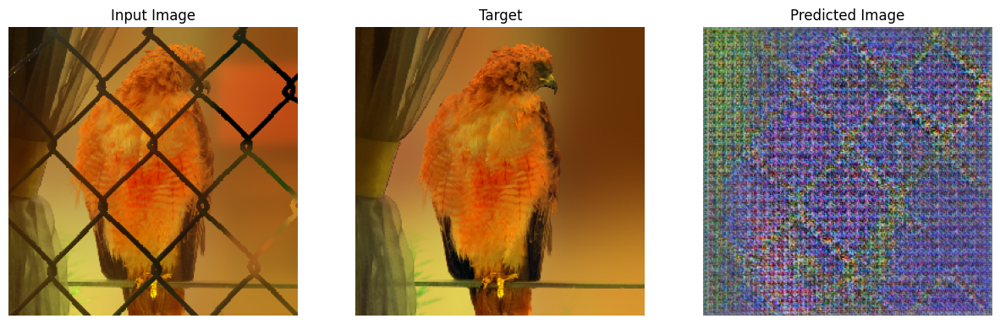

In [132]:
student_model = tf.keras.models.load_model(checkpoint_prefix2)
for example_input, example_target in test_dataset.take(1):
  generate_images(target_model, example_input, example_target)

In [122]:
demo_model = tf.keras.Model(inputs=student_model.input,outputs=student_model.layers[-2].output)
last_layer = teacher_model.layers[-1]
target_model = tf.keras.Sequential()
target_model.add(demo_model)
target_model.add(last_layer)

In [103]:
# 
# print(last_layer.input_shape, last_layer.output_shape)
dl_layer = demo_model.layers[-1]
print(dl_layer.input_shape)

[(None, 128, 128, 64), (None, 128, 128, 64)]


In [134]:
student_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_10 (Sequential)     (None, 128, 128, 64  3072        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_11 (Sequential)     (None, 64, 64, 128)  131584      ['sequential_10[0][0]']          
                                                                                            

In [ ]:
try:
  %load_ext tensorboard
  logdir = log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)
  %tensorboard --logdir logs/fit
except:
  pass

In [ ]:
t_diff = 0
s_diff = 0
for n, (input, target) in train_acc_dataset.enumerate():
  teacher_output  = teacher_model(input, training = False)
  student_output  = student_model(input, training = False)
  teacher_flatten = tf.reshape(tf.abs(target - teacher_output), [-1])
  student_flatten = tf.reshape(tf.abs(target - student_output), [-1])
  teacher_flatten.numpy()
  student_flatten.numpy()
  t_diff += np.mean(teacher_flatten)
  s_diff += np.mean(student_flatten)

print(t_diff)
print(s_diff)

0.6297135353088379
0.6297138333320618


In [ ]:
t_diff /= len(train_acc_dataset)
print(t_diff)
s_diff /= len(train_acc_dataset)
print(s_diff)

0.6297135353088379
0.6297138333320618


In [ ]:
final_diff = 0
for n, (input, target) in test_acc_dataset.enumerate():
  teacher_output  = teacher_model(input, training = False)
  student_output  = student_model(input, training = False)
  final_flatten = tf.reshape(tf.abs(student_output - teacher_output), [-1])
  final_flatten.numpy()
  final_diff += np.mean(final_flatten)

print(final_diff)
print(len(test_acc_dataset))
final_diff /= len(test_acc_dataset)
print(final_diff)

1.7903816114994697e-05
1
1.7903816114994697e-05


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/De-fencing_Dataset/val/0.png'

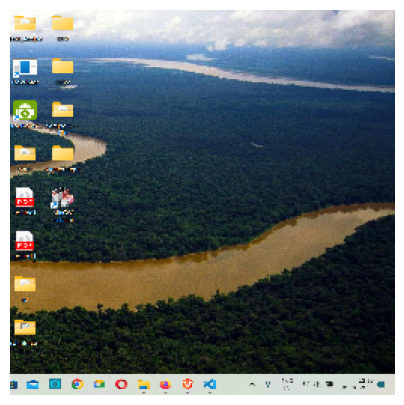

In [ ]:
for n, (example_input, example_target) in test_acc_dataset.enumerate():
  path = '/content/drive/MyDrive/De-fencing_Dataset/val/'
  generate_final_input_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/teacher_val/'
  generate_final_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/student_val/'
  generate_final_images(student_model, example_input, example_target, path, tf.keras.backend.eval(n))

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/De-fencing_Dataset/paper/0.png'

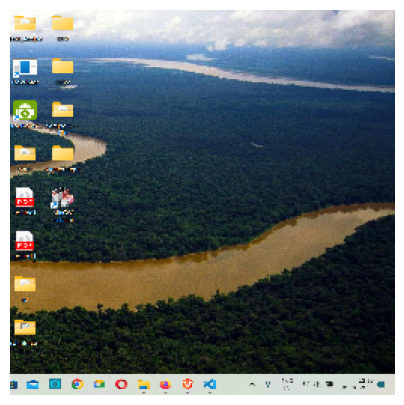

In [ ]:
for n, (example_input, example_target) in papers_dataset.enumerate():
  path = '/content/drive/MyDrive/De-fencing_Dataset/paper/'
  generate_final_input_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/teacher_paper/'
  generate_final_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/student_paper/'
  generate_final_images(student_model, example_input, example_target, path, tf.keras.backend.eval(n))

FileNotFoundError: ignored

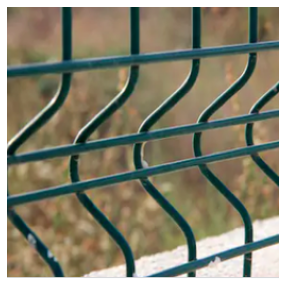

In [ ]:
for n, (example_input, example_target) in irregular_dataset.enumerate():
  path = '/content/drive/MyDrive/De-fencing_Dataset/irregular/'
  generate_final_input_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/teacher_irregular/'
  generate_final_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/student_irregular/'
  generate_final_images(student_model, example_input, example_target, path, tf.keras.backend.eval(n))

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/De-fencing_Dataset/broken/0.png'

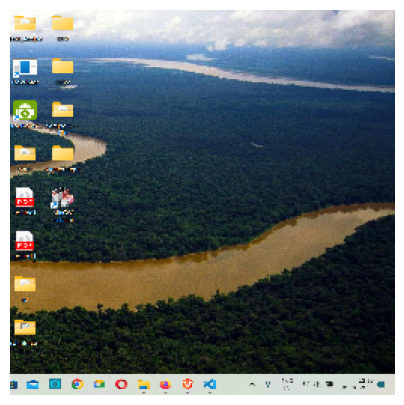

In [ ]:
for n, (example_input, example_target) in broken_dataset.enumerate():
  path = '/content/drive/MyDrive/De-fencing_Dataset/broken/'
  generate_final_input_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/teacher_broken/'
  generate_final_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/student_broken/'
  generate_final_images(student_model, example_input, example_target, path, tf.keras.backend.eval(n))

In [ ]:
for n, (example_input, example_target) in flip_dataset.enumerate():
  path = '/content/drive/MyDrive/De-fencing_Dataset/flip/'
  generate_final_input_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/teacher_flip/'
  generate_final_images(teacher_model, example_input, example_target, path, tf.keras.backend.eval(n))
  path = '/content/drive/MyDrive/De-fencing_Dataset/student_flip/'
  generate_final_images(student_model, example_input, example_target, path, tf.keras.backend.eval(n))

In [ ]:
image = Image.open(r"/DATA/shorya/ImageDefencing/train_images/images")
image.convert("RGBA") # Convert this to RGBA if possible

pixel_data = image.load()

if image.mode == "RGBA":
    # If the image has an alpha channel, convert it to white
    # Otherwise we'll get weird pixels
    for y in range(image.size[1]): # For each row ...
        for x in range(image.size[0]): # Iterate through each column ...
            # Check if it's opaque
            if pixel_data[x, y][3] < 255:
                # Replace the pixel data with the colour white
                pixel_data[x, y] = (255, 255, 255, 255)
image.save("noAlphaChannelImage.png")

In [ ]:
from PIL import Image